#  AIRBNB Capstone Project - Reviews.csv Cleaning/processing/munging

##  This Jupyter notebook is for cleaning and processing the reviews. some EDA following the Vader sentiment analysis is also carried out

1. The data is imported from reviews.csv
2. some initial cleaning and plotting of the review dates is carried out to see if there is any significant time trend.
3. the language of each review is determined using langdetect.
4. not english reviews are dropped as Vader only works on english language.
5. Vader sentiment analysis is carried out on the reviews. 
6. EDA to visualise the sentiment trends
7. The reviews are vectorized using TFidf to determine significant words.


In [2]:
import pandas as pd
import numpy as np
import scipy
import pickle
import math

from wordcloud import WordCloud, STOPWORDS
from PIL import Image
import urllib
import requests

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm

#Import custom Airbnb Fonts for plotting
cereal_med = fm.FontProperties(fname='../resources/Font_Cereal/AirbnbCereal-Medium.ttf')
cereal_light = fm.FontProperties(fname='../resources/Font_Cereal/AirbnbCereal-Light.ttf')
cereal_bold = fm.FontProperties(fname='../resources/Font_Cereal/AirbnbCereal-bold.ttf')
cereal_book = fm.FontProperties(fname='../resources/Font_Cereal/AirbnbCereal-Book.ttf')
cereal_X_bold = fm.FontProperties(fname='../resources/Font_Cereal/AirbnbCereal-ExtraBold.ttf')


import seaborn as sns
import datetime
from dateutil.relativedelta import relativedelta
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

import cufflinks as cf

import plotly.plotly as py
import plotly.tools as tls
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

import textacy
from textacy.preprocess import preprocess_text

init_notebook_mode(connected=False)
cf.go_offline()

sns.set(font_scale=1.5)
plt.style.use('fivethirtyeight')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import warnings
warnings.simplefilter('ignore')
warnings.filterwarnings("ignore", message="numpy.ufunc size changed")

pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', 100)

## The City & loading the reviews

In [3]:
while True:
    city = (str(input('Which city do you wish to analyse? (Berlin/London):'))).capitalize()
    if city == 'Berlin':
        break
    elif city=='London':
        break
    else:
        print('This city is not ready to be analysed, please try again : ')
                

Which city do you wish to analyse? (Berlin/London):Berlin


In [15]:
reviews = pd.read_csv('../Capstone_DATA/{0}/reviews.csv'.format(city))

In [16]:
reviews.listing_id.nunique()

18638

In [17]:
reviews['date'] = pd.to_datetime(reviews.date)

In [18]:
reviews.dropna(inplace=True)

In [19]:
reviews = reviews[~reviews.comments.str.contains(
    'The host canceled this reservation')]

In [20]:
reviews = reviews[~reviews.comments.str.contains(
    'The reservation was canceled')]

In [21]:
reviews[:10]

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2015,69544350,2016-04-11,7178145,Rahel,Mein Freund und ich hatten gute gemütliche vie...
1,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...
2,2015,71605267,2016-04-26,30048708,Victor,Un appartement tres bien situé dans un quartie...
3,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ..."
4,2015,74293504,2016-05-14,10414887,Romina,"Buena ubicación, el departamento no está orden..."
5,2015,74690922,2016-05-16,39859815,Eil,"Jan ist super flexibel und gut zu erreichen, w..."
6,2015,76603178,2016-05-28,29323516,Laurent,"We had a very nice stay in Berlin, thanks to J..."
7,2015,77296201,2016-05-31,9025122,Rasmus,"Great location close to Mauerpark, Kastanienal..."
8,2015,77834906,2016-06-03,39244464,Sabine,"Perfekte Lage, perfekte Ausstattung, perfekter..."
9,2015,82322683,2016-06-27,73902920,Mag,"Apartment very well located, close to everythi..."


In [22]:
review_count = reviews.groupby('date').count()

In [23]:
reviews['length'] = reviews.comments.str.split().str.len()
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length
0,2015,69544350,2016-04-11,7178145,Rahel,Mein Freund und ich hatten gute gemütliche vie...,88
1,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...,29
2,2015,71605267,2016-04-26,30048708,Victor,Un appartement tres bien situé dans un quartie...,47
3,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ...",10
4,2015,74293504,2016-05-14,10414887,Romina,"Buena ubicación, el departamento no está orden...",53


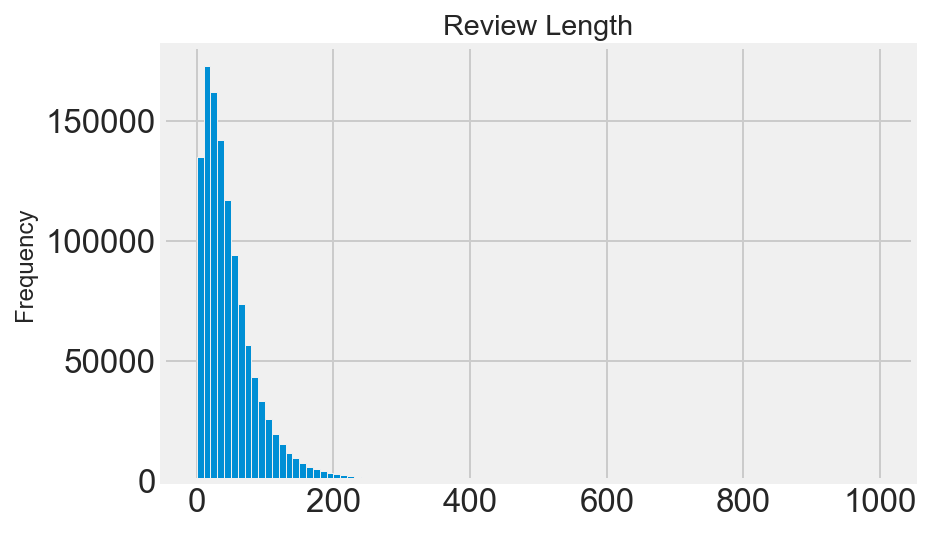

In [12]:
reviews.length.plot(kind='hist', title='Review Length'  # ,xTitle='Length of Review'
                    , bins=100);

In [ ]:
trace1 = go.Scatter(x=review_count.resample('W').mean()['id'].index,
                    y=review_count.resample('W').mean()['id'],
                    name='Weekly Mean')
trace2 = go.Scatter(x=review_count.resample('M').mean()['id'].index,
                    y=review_count.resample('M').mean()['id'],
                    name='Monthly Mean')
layout = go.Layout(
    title='Reviews Per Week',
    yaxis=dict(
        title='Number of Reviews'),

    xaxis=dict(
        title='Date'
    )
)

config = {'scrollZoom': False,
          'displayModeBar': False,
          'editable': False
          }
fig = go.Figure(data=[trace1, trace2], layout=layout)
iplot(fig, config=config)

In [ ]:
reviews_sample = reviews.sample(n=1000)

## Determine the language of each review and filter by english reviews

#### Function to check language with error checking

In [ ]:
# Vader does not work on non-english language, so I want to exclude these reviews for now.
# I need to calculate which reviews are in english. I will use langdetect from google to detirmine this
# https://github.com/Mimino666/langdetect for the package details

from langdetect import detect


def lang_detect(text):
    """fuction for error management due to error when no text is contained in the comment"""
    try:
        return detect(text)
    except:
        return 'na'

##### Better check that the function works

In [16]:
# Test out
print(lang_detect(np.nan))
print(lang_detect('hello there, nice coat'))
print(lang_detect('hola mi amigo, que pasa'))

na
en
es


##### And how long it will take. The results look approriate.

In [ ]:
# Trial run on small sample
%time reviews_sample['language'] = reviews_sample.comments.apply(lang_detect)

reviews_sample.head()

### And now for the entire data set

In [18]:
# This will take some time...

In [19]:
%time reviews['language'] = reviews.comments.apply(lang_detect)
reviews.head()

CPU times: user 26min 20s, sys: 56.8 s, total: 27min 17s
Wall time: 27min 28s


,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language
0,2015,69544350,2016-04-11,7178145,Rahel,Mein Freund und ich hatten gute gemütliche vie...,88,de
1,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...,29,en
2,2015,71605267,2016-04-26,30048708,Victor,Un appartement tres bien situé dans un quartie...,47,fr
3,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ...",10,en
4,2015,74293504,2016-05-14,10414887,Romina,"Buena ubicación, el departamento no está orden...",53,es


In [20]:
# how many reviews from each language
reviews.language.value_counts()

en       263457
de        77154
fr        16862
es        12164
it         4865
nl         3905
ru         2312
ko         1641
pt         1394
da         1360
zh-cn      1166
na          646
sv          611
no          608
af          589
ro          566
ca          538
pl          535
fi          419
cs          400
so          275
ja          262
tr          178
el          170
id          167
hu          159
cy          101
tl          100
sk           65
hr           63
et           61
vi           42
he           42
zh-tw        34
sw           32
uk           30
sl           27
lt           17
bg           17
sq           11
lv           10
mk           10
th            7
ar            2
Name: language, dtype: int64

##### Subset on the english reviews

In [21]:
# subset on english only reviews for vader analysis
reviews_en = reviews[reviews.language == 'en'].copy()

## Vader Sentiment analysis

### Preprocess the text to remove unwanted information

In [22]:
# Preprocess the text to help aid sentiment analysis


text = reviews_en['comments'].values
clean_text = [preprocess_text(x, fix_unicode=True, lowercase=True, transliterate=True,
                              no_urls=True, no_emails=True, no_phone_numbers=True, no_currency_symbols=True,
                              no_punct=True, no_accents=True)
              for x in text]

In [23]:
vader = SentimentIntensityAnalyzer()

In [24]:
reviews_en['vader_neg'] = 0
reviews_en['vader_pos'] = 0
reviews_en['vader_neu'] = 0
reviews_en['vader_compound'] = 0

for i, q in enumerate(clean_text):
    vs = vader.polarity_scores(q)
    reviews_en.iloc[i, -4] = vs['neg']
    reviews_en.iloc[i, -3] = vs['pos']
    reviews_en.iloc[i, -2] = vs['neu']
    reviews_en.iloc[i, -1] = vs['compound']
    if i % 20000 == 0:
        print(f'{i} reviews completed')

0 reviews completed
20000 reviews completed
40000 reviews completed
60000 reviews completed
80000 reviews completed
100000 reviews completed
120000 reviews completed
140000 reviews completed
160000 reviews completed
180000 reviews completed
200000 reviews completed
220000 reviews completed
240000 reviews completed
260000 reviews completed


In [25]:
reviews_en.tail()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language,vader_neg,vader_pos,vader_neu,vader_compound
401935,29628409,345482795,2018-11-05,223211554,Luca,The host is friendly. The place was bigger and...,25,en,0.0,0.242,0.758,0.6908
401938,29640657,343947591,2018-11-02,222267323,Shriram,Great place to stay and a bit far though. Valu...,17,en,0.0,0.449,0.551,0.8910
401939,29640657,345497600,2018-11-05,72296860,Lenard,"The place is great. Very spacey and clean, wit...",55,en,0.0,0.331,0.669,0.9757
401941,29664434,345546971,2018-11-05,19126626,Jan,This Appartment is super comfortable and Claud...,41,en,0.0,0.208,0.792,0.8750
401949,29721020,344679554,2018-11-04,36693253,Hai,"Nice, quite close to the center - 15m walk",9,en,0.0,0.286,0.714,0.4215


#### Save the sentiment analysis to disk

In [26]:
reviews_en.to_csv(
    '../Capstone_DATA/{0}/{0}_reviews_sent_en'.format(city), index=False)

In [24]:
reviews_en = pd.read_csv(
    '../Capstone_DATA/{0}/{0}_reviews_sent_en'.format(city))

#### EDA on the vader processed reviews

In [28]:
reviews_en['sent'] = reviews_en.vader_compound.map(lambda x: 'pos' if x >= 0.05
                                                                         else 'neg' if x <= -0.05
                                                                         else 'neu')
reviews_en.sent.value_counts()

pos    258419
neg      2988
neu      2050
Name: sent, dtype: int64

In [29]:
reviews_en[reviews_en.sent=='pos']['comments'].head()

0    Jan was very friendly and welcoming host! The ...
1    It is really nice area, food, park, transport ...
2    We had a very nice stay in Berlin, thanks to J...
3    Great location close to Mauerpark, Kastanienal...
4    Apartment very well located, close to everythi...
Name: comments, dtype: object

In [19]:
reviews_en.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,length,language,vader_neg,vader_pos,vader_neu,vader_compound
0,2015,69990732,2016-04-15,41944715,Hannah,Jan was very friendly and welcoming host! The ...,29,en,0.0,0.484,0.516,0.9668
1,2015,73819566,2016-05-10,63697857,Judy,"It is really nice area, food, park, transport ...",10,en,0.0,0.459,0.541,0.7778
2,2015,76603178,2016-05-28,29323516,Laurent,"We had a very nice stay in Berlin, thanks to J...",59,en,0.0,0.341,0.659,0.9772
3,2015,77296201,2016-05-31,9025122,Rasmus,"Great location close to Mauerpark, Kastanienal...",23,en,0.0,0.266,0.734,0.8221
4,2015,82322683,2016-06-27,73902920,Mag,"Apartment very well located, close to everythi...",42,en,0.0,0.189,0.811,0.8439


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


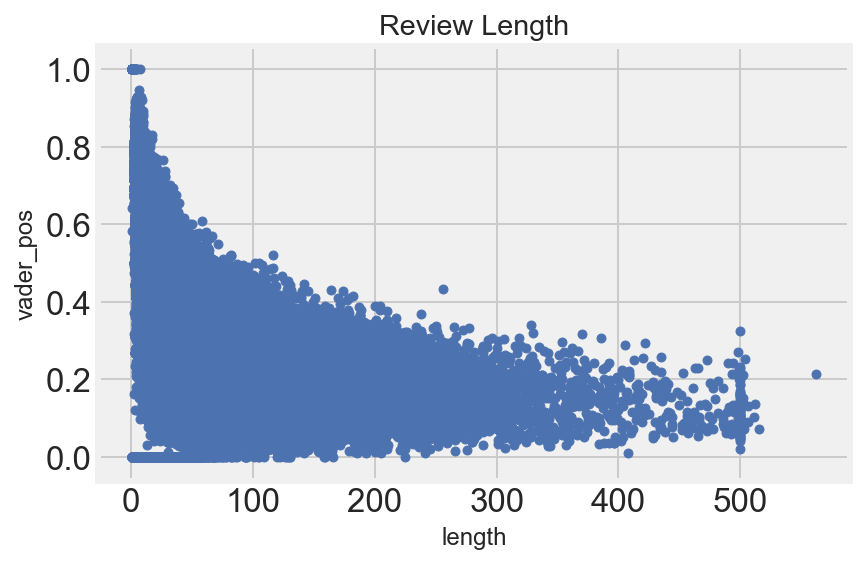

In [31]:
reviews_en.plot(x='length', y='vader_pos',
                kind='scatter', title='Review Length');
#
# mode='markers',
# xTitle='Length of Review vs Positive Sentiment')
# yTitle = 'vader_pos score')

In [32]:
# listing_en_comments['comments'] = reviews_en.comments.str.replace('\n', " ")\
#     .str.replace('\r', "")\
#     .str.replace("\'", "")\
#     .str.replace('\r', "")
#listing_comments_reviews_grpd = pd.merge(listing_avg_sentiment, listing_en_grouped[[
            #      'listing_id', 'comments_grouped']], how='outer', left_on='listing_id', right_on='listing_id')

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


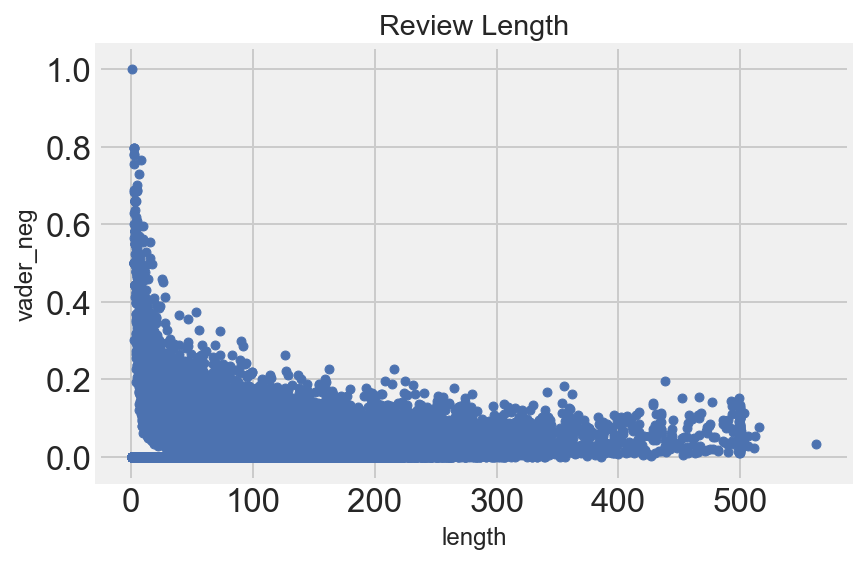

In [33]:
reviews_en.plot(x='length', y='vader_neg', kind='scatter',
                title='Review Length');  # size=3,
# ,
# mode='markers',
#xTitle='Length of Review',
# yTitle = 'vader_neg score')

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


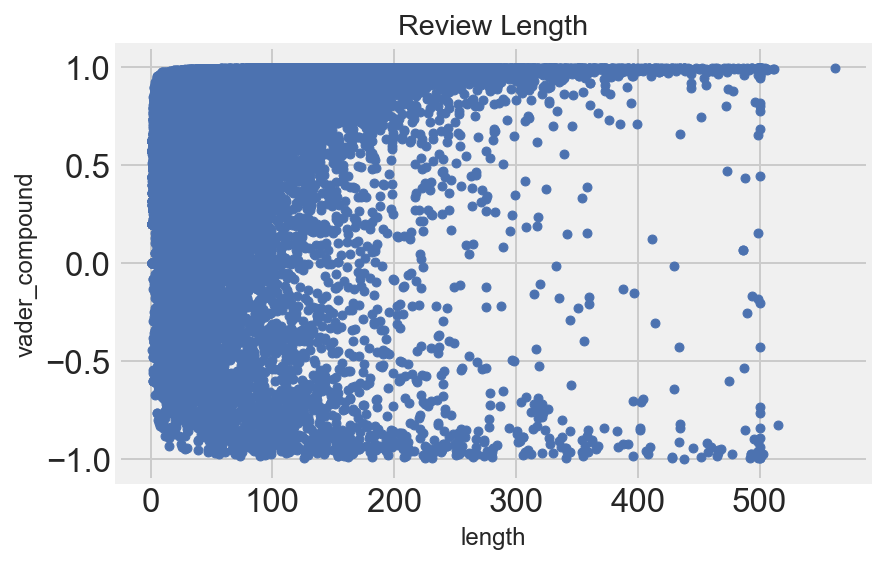

In [34]:
reviews_en.plot(x='length', y='vader_compound',
                kind='scatter', title='Review Length');
# size=3,
# mode='markers',
#xTitle='Length of Review',
#yTitle = 'vader_compound score',
# asImage=True, filename='Review_length_vs_vader.png')

In [35]:
trace1 = go.Histogram(y=reviews_en.vader_pos,
                      name='positive sentiment counts', opacity=0.5, nbinsy=80)
trace2 = go.Histogram(y=reviews_en[reviews_en.vader_neg != 0].vader_neg, name='negative sentiment counts',
                      opacity=0.5, nbinsy=80)
yaxis = go.layout.YAxis(title='vader Sentiment')
layout = go.Layout(title='Positive and Negative Vader sentiment',
                   barmode='overlay', yaxis=yaxis)
data = [trace1, trace2]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [36]:
trace1 = go.Histogram(y=reviews_en.vader_neu,
                      name='Neutral sentiment counts', opacity=0.5, nbinsy=80)
trace2 = go.Histogram(y=reviews_en.vader_compound,
                      name='Compound sentiment counts', opacity=0.5, nbinsy=80)

yaxis = go.layout.YAxis(title='vader Sentiment')
layout = go.Layout(title='Nuetral and Compound Vader sentiment',
                   barmode='overlay', yaxis=yaxis)
data = [trace1, trace2]
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [37]:
reviews_en['exp_vader_compound'] = reviews_en.vader_compound.map(
    lambda x: math.exp(x))

In [38]:
reviews_en['exp_exp_vader_compound'] = reviews_en.vader_compound.map(
    lambda x: math.exp(math.exp(x)))

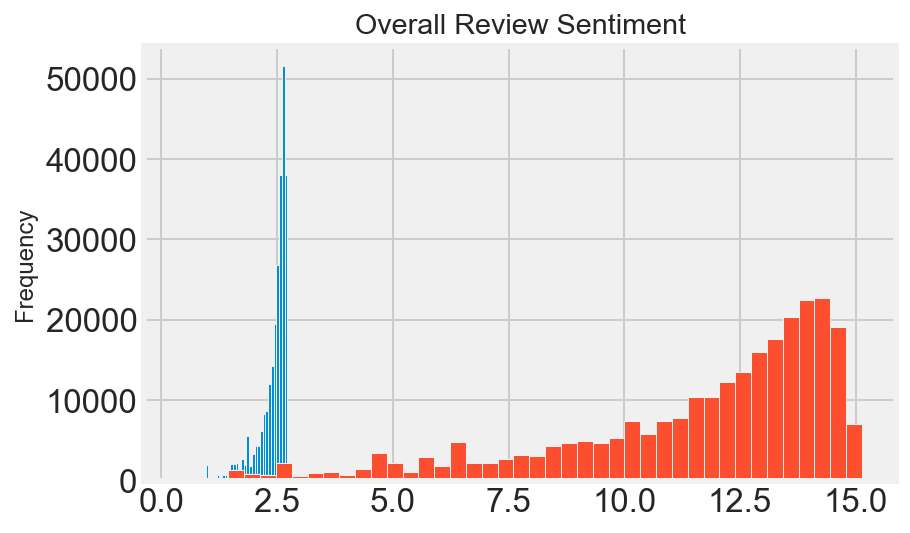

In [39]:
reviews_en.exp_vader_compound.plot(
    kind='hist', title='Overall Review Sentiment', bins=40)
# xTitle='Vader Sentiment',yTitle='Review count',
# asImage=True, filename='Review_Sentiment_histogram.png')
reviews_en.exp_exp_vader_compound.plot(
    kind='hist', title='Overall Review Sentiment', bins=40)

In [40]:
reviews_en['vader_pos_x_length'] = reviews_en.vader_pos*reviews_en.length

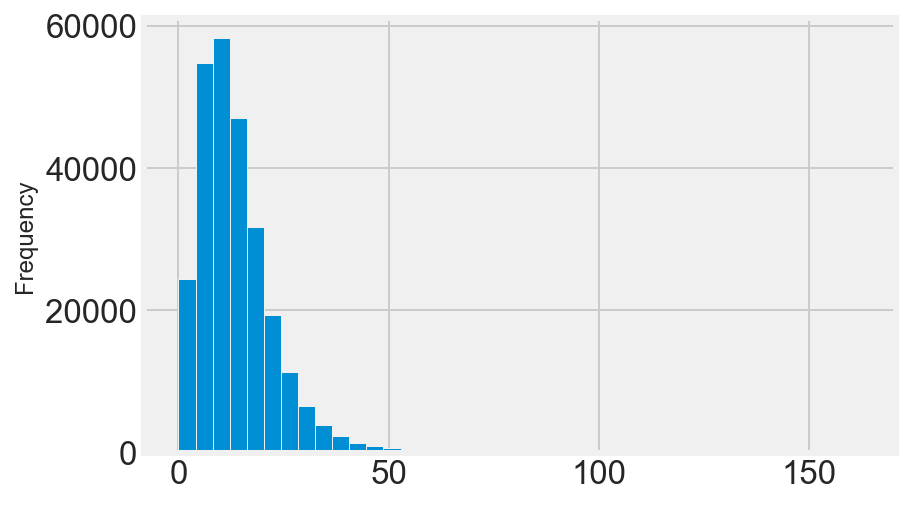

In [41]:
reviews_en.vader_pos_x_length.plot(kind='hist', bins=40)

In [42]:
reviews_en.columns

Index(['listing_id', 'id', 'date', 'reviewer_id', 'reviewer_name', 'comments',
       'length', 'language', 'vader_neg', 'vader_pos', 'vader_neu',
       'vader_compound', 'sent', 'exp_vader_compound',
       'exp_exp_vader_compound', 'vader_pos_x_length'],
      dtype='object')

### Read in the listing Data

In [55]:
listing = pd.read_csv('../Capstone_DATA/Berlin/listings.csv'.format(city),
                      index_col=0,
                      parse_dates=True,
                      infer_datetime_format=True
                      )

In [56]:
host_names=set([name.lower() for name in listing.host_name.dropna()])

In [58]:
descriptions=listing.description.copy()

In [59]:
listing=[]

### Group the reviews by listing ID aggregating by mean()

In [44]:
listing_avg_sentiment = reviews_en.groupby(reviews_en.listing_id)\
    .agg(np.mean)[['length', 'vader_neg', 'vader_pos', 'vader_neu',
       'vader_compound', 'exp_vader_compound',
       'exp_exp_vader_compound', 'vader_pos_x_length']]

In [45]:
listing_avg_sentiment.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16950 entries, 2015 to 29721020
Data columns (total 8 columns):
length                    16950 non-null float64
vader_neg                 16950 non-null float64
vader_pos                 16950 non-null float64
vader_neu                 16950 non-null float64
vader_compound            16950 non-null float64
exp_vader_compound        16950 non-null float64
exp_exp_vader_compound    16950 non-null float64
vader_pos_x_length        16950 non-null float64
dtypes: float64(8)
memory usage: 1.2 MB


#### histogram plot of the average sentiment

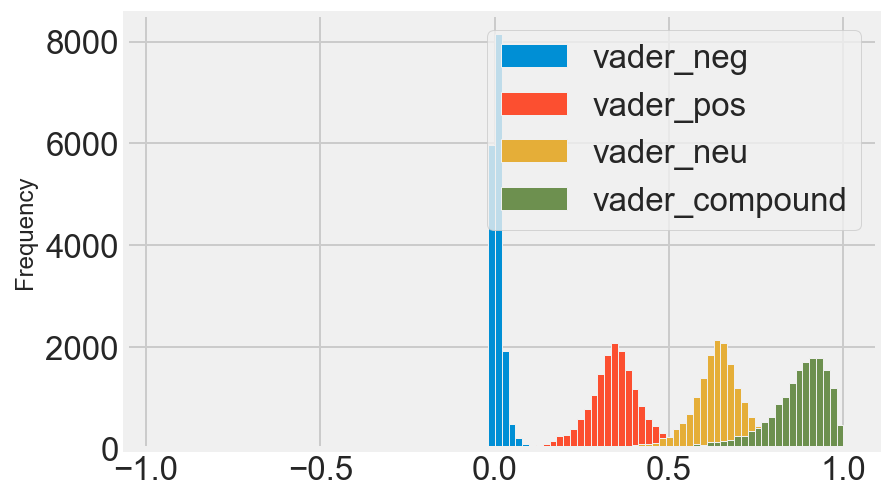

In [46]:
listing_avg_sentiment.drop(
    columns=['length','exp_exp_vader_compound','exp_vader_compound',
             'vader_pos_x_length']).plot(kind='hist', bins=100);

#### Save the aggregated data to csv

In [47]:
listing_avg_sentiment.to_csv(
    '../Capstone_DATA/{0}/{0}_avg_listing_sent_en'.format(city), index=True)

In [48]:
listing_avg_sentiment = pd.read_csv(
    '../Capstone_DATA/{0}/{0}_avg_listing_sent_en'.format(city))

In [49]:
listing_avg_sentiment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16950 entries, 0 to 16949
Data columns (total 9 columns):
listing_id                16950 non-null int64
length                    16950 non-null float64
vader_neg                 16950 non-null float64
vader_pos                 16950 non-null float64
vader_neu                 16950 non-null float64
vader_compound            16950 non-null float64
exp_vader_compound        16950 non-null float64
exp_exp_vader_compound    16950 non-null float64
vader_pos_x_length        16950 non-null float64
dtypes: float64(8), int64(1)
memory usage: 1.2 MB


##### How many positive/nuetral/negative listings are there?

In [50]:
listing_avg_sentiment['sent'] = listing_avg_sentiment.vader_compound.map(lambda x: 'pos' if x >= 0.05
                                                                         else 'neg' if x <= -0.05
                                                                         else 'neu')
listing_avg_sentiment.sent.value_counts()

pos    16851
neg       56
neu       43
Name: sent, dtype: int64

### Join the review comments for each listing

In [52]:
review_comment_grouped = reviews.groupby(
    by='listing_id', as_index=False, sort=False).agg(' '.join)
print(review_comment_grouped.info())


In [53]:
df_ids = pd.merge(listing_avg_sentiment, review_comment_grouped[[
                  'listing_id', 'comments']], how='left', left_on='listing_id', right_on='listing_id')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18165 entries, 0 to 18164
Data columns (total 4 columns):
listing_id       18165 non-null int64
reviewer_name    18165 non-null object
comments         18165 non-null object
language         18165 non-null object
dtypes: int64(1), object(3)
memory usage: 709.6+ KB


In [55]:
df_ids=pd.merge(listing[['id']],df_ids,how='left',left_on='id',right_on='listing_id')
listing=[]

In [56]:
df_ids.dropna(axis=0,inplace=True)

In [57]:
df_ids['comments_grouped'] = review_comment_grouped.comments.str.replace('\n', " ")\
    .str.replace('\r', "")\
    .str.replace("\'", "")\
    .str.replace('\r', "")

In [58]:
df_ids.shape

(16849, 13)

In [59]:
df_ids.drop(columns=['id'],inplace=True)

In [60]:
df_ids.to_csv('../Capstone_DATA/{0}/{0}_reviews_grouped_sent_comments'.format(city))

In [20]:
listing_avg_sentiment=[]
reviews=[]
review_comment_grouped=[]

## Vectorizing the comments using SKLearn

In [9]:
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

In [10]:
stop = stopwords.words(["dutch","finnish","german","italian", "portuguese","spanish","turkish","danish","english",
"french","hungarian","norwegian","russian","swedish"]) +['apartment', 'berlin', 'great', 'airbnb', 'appartement',
        'apartement', 'flat', 'room', 'stay', 'much', 'could', 'wohnung','get','would','us','nice','get','place']

In [11]:
df_ids=pd.read_csv('../Capstone_DATA/{0}/{0}_reviews_grouped_sent_comments'.format(city))

### TFiDF

In [66]:
tfidf = TfidfVectorizer(analyzer='word',
                        stop_words=stop,
                        strip_accents='unicode',
                        lowercase=True,
                        ngram_range=(1,3),
                        min_df=10,
                        max_df=0.99999
                        )
tfidf.fit(df_ids.comments_grouped)
tfidf_matrix = tfidf.transform(df_ids.comments_grouped)
tfidf_matrix

<16849x145300 sparse matrix of type '<class 'numpy.float64'>'
	with 8670212 stored elements in Compressed Sparse Row format>

In [67]:
tfidf_df = pd.DataFrame(tfidf_matrix.sum(axis=0).ravel(),
                 columns=tfidf.get_feature_names()).T.sort_index(by=0, ascending=False)[:1000]
tfidf_df[:20]

,0
location,518.599652
clean,481.232836
host,455.751165
really,452.725971
good,429.343583
super,419.310728
recommend,378.747032
everything,357.970437
close,330.101030
well,324.905822


### Count Vectorizer

In [68]:
cvec = CountVectorizer(analyzer='word',
                       stop_words=stop,
                       strip_accents='unicode',
                       lowercase=True,
                       ngram_range=(1,3),
                       min_df=10,
                       max_df=0.99999
                       )
cvec.fit(df_ids.comments_grouped)
cvec_matrix = cvec.transform(df_ids.comments_grouped)
cvec_matrix

<16849x145300 sparse matrix of type '<class 'numpy.int64'>'
	with 8670212 stored elements in Compressed Sparse Row format>

In [69]:
cvec_neg_matrix = cvec.transform(df_ids[(df_ids.sent == 'neg') | (df_ids.sent == 'neu')].comments_grouped)
cvec_neg_matrix

<95x145300 sparse matrix of type '<class 'numpy.int64'>'
	with 32849 stored elements in Compressed Sparse Row format>

In [70]:
neg_words = pd.DataFrame(cvec_neg_matrix.sum(axis=0).ravel(),
                         columns=cvec.get_feature_names()).T.sort_index(by=0, ascending=False)[:1000]
neg_words[:50]

,0
host,286
location,267
clean,254
really,242
close,222
good,213
super,210
recommend,198
everything,188
well,152


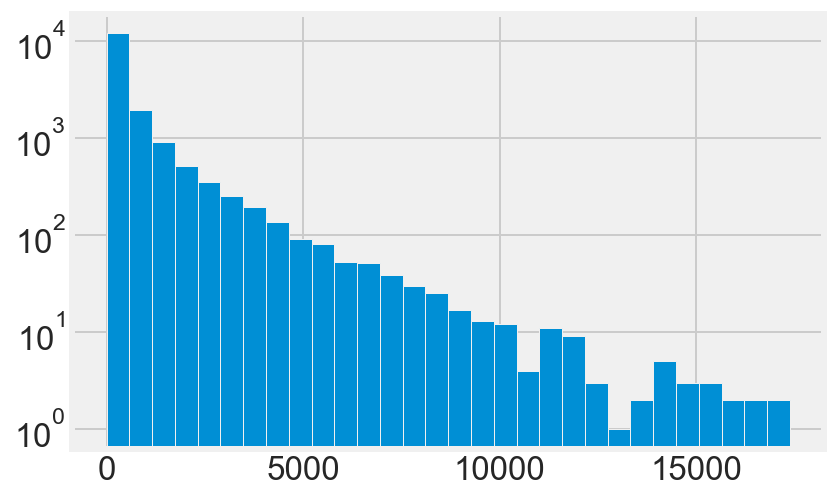

In [71]:
plt.hist(cvec_matrix.sum(axis=1),log=True,bins=30);

In [72]:
cvec_pos = pd.DataFrame(cvec_matrix.sum(axis=0).ravel(),
                 columns=cvec.get_feature_names()).T.sort_index(by=0, ascending=False)[:1000]
cvec_pos[:50]

,0
location,81543
clean,76997
host,67032
really,63401
good,59508
recommend,56467
super,54946
everything,50500
close,46865
well,46400


#### Lets just look at the n_grams 2 & 3

In [73]:
cvec_ngram = CountVectorizer(analyzer='word',
                       stop_words=stop+['recommend'],
                       strip_accents='unicode',
                       lowercase=True,
                       ngram_range=(2,3),
                       #min_df=10,
                       #max_df=0.99999
                       )
cvec_ngram.fit(df_ids.comments_grouped)
cvec_ngram_matrix = cvec_ngram.transform(df_ids.comments_grouped)
cvec_pos_ngram = pd.DataFrame(cvec_ngram_matrix.sum(axis=0).ravel(),
                 columns=cvec_ngram.get_feature_names()).T.sort_index(by=0, ascending=False)[:1000]
cvec_pos_ngram[:50]

,0
public transport,12107
walking distance,9715
everything need,9058
well located,8032
good location,7927
everything needed,7579
highly recommended,7298
wohl gefuhlt,7214
public transportation,6434
well equipped,6093


In [74]:
cvec_neg_matrix_ngrams = cvec_ngram.transform(df_ids[(df_ids.sent == 'neg') | (df_ids.sent == 'neu')].comments_grouped)
neg_words_ngram = pd.DataFrame(cvec_neg_matrix_ngrams.sum(axis=0).ravel(),
                         columns=cvec_ngram.get_feature_names()).T.sort_index(by=0, ascending=False)[:1000]
neg_words_ngram[:50]

,0
public transport,43
really enjoyed,33
everything need,31
well located,31
highly recommended,30
good location,29
walking distance,29
bars restaurants,28
everything needed,28
bahn station,25


#### Save the models for later use

In [75]:
# save the TFiDF model to disk
filename = 'tfidf_model.sav'
pickle.dump(tfidf, open(filename, 'wb'))

filename = 'cvec_model.sav'
pickle.dump(cvec, open(filename, 'wb'))

# some time later...

# load the model from disk
#loaded_model = pickle.load(open(filename, 'rb'))

# print(result)

In [76]:
scipy.sparse.save_npz('tfidf_matrix.npz', tfidf_matrix)

In [77]:
scipy.sparse.save_npz('cvec_matrix.npz', cvec_matrix)
#cvec_matrix = scipy.sparse.load_npz('cvec_matrix.npz')
#s_matrix = scipy.sparse.load_npz('tfidf_matrix.npz')

### AirBnb Word clouds

In [53]:
air_bnb_logo = np.array(Image.open('../resources/airbnb-logo_bold.png'))

def word_cloud_gen(word_df,mask,title):
    wc_gen = {}
    wc = WordCloud(mode='RGBA', background_color='white',
                   random_state=2,stopwords=STOPWORDS,mask=mask,
                  color_func=lambda *args, **kwargs: (255, 90, 95),
                  font_path='../resources/Font_Cereal/AirbnbCereal-Medium.ttf')

    fig, ax = plt.subplots(figsize=(8,8))
    ax.set_title(title,fontproperties=cereal_bold, size=32)
    wc_gen = wc.generate_from_frequencies(dict(word_df.reset_index().values))
    ax.imshow(wc_gen, interpolation='bilinear')
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()

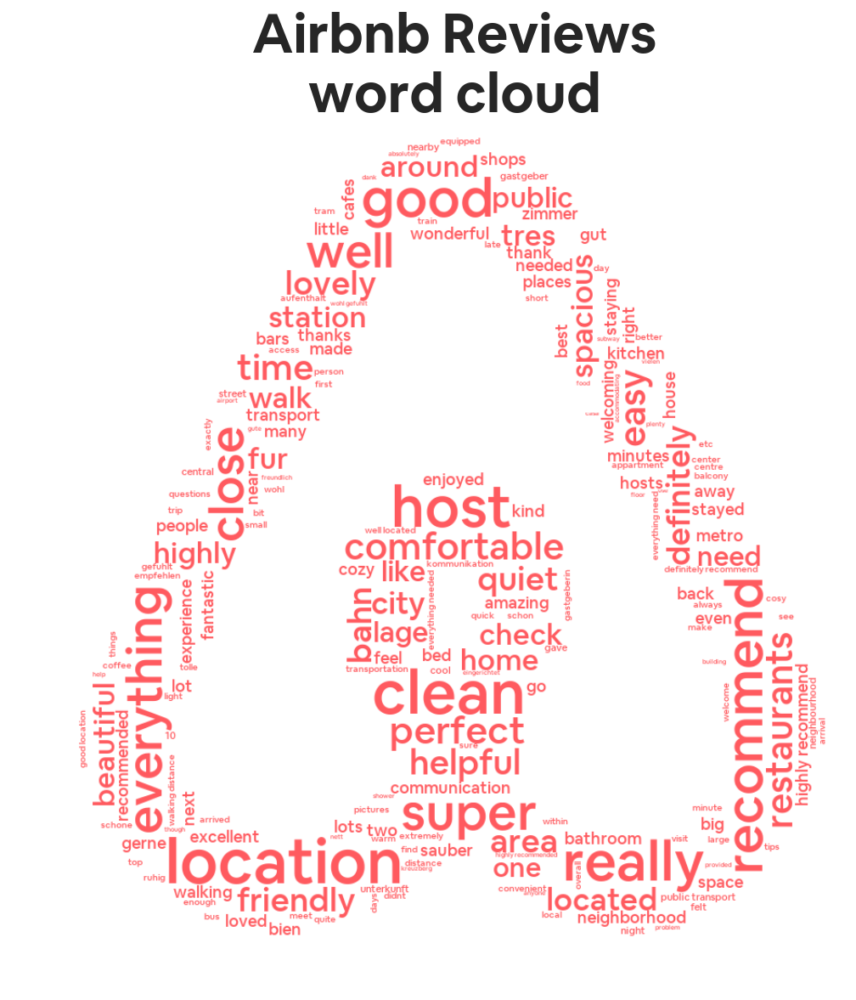

In [79]:
word_cloud_gen(cvec_pos,air_bnb_logo)

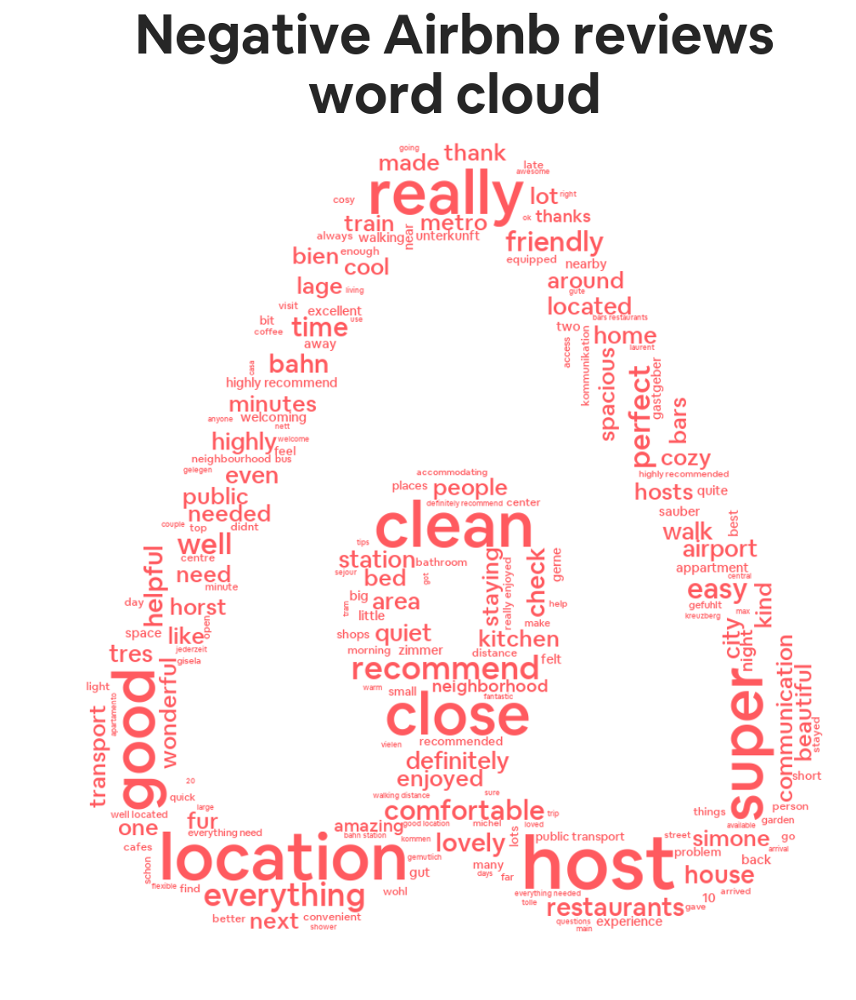

In [80]:
word_cloud_gen(neg_words,air_bnb_logo,'Negative Airbnb reviews\nword cloud')

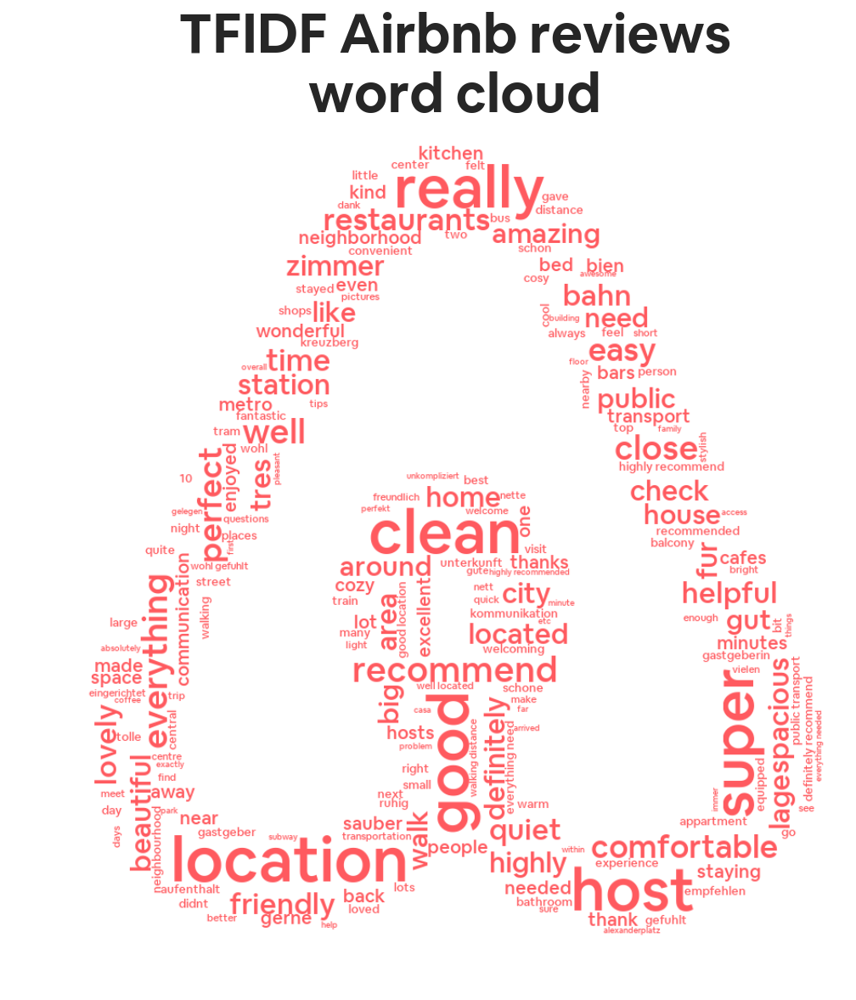

In [81]:
word_cloud_gen(tfidf_df,air_bnb_logo,'TFIDF Airbnb reviews\nword cloud')

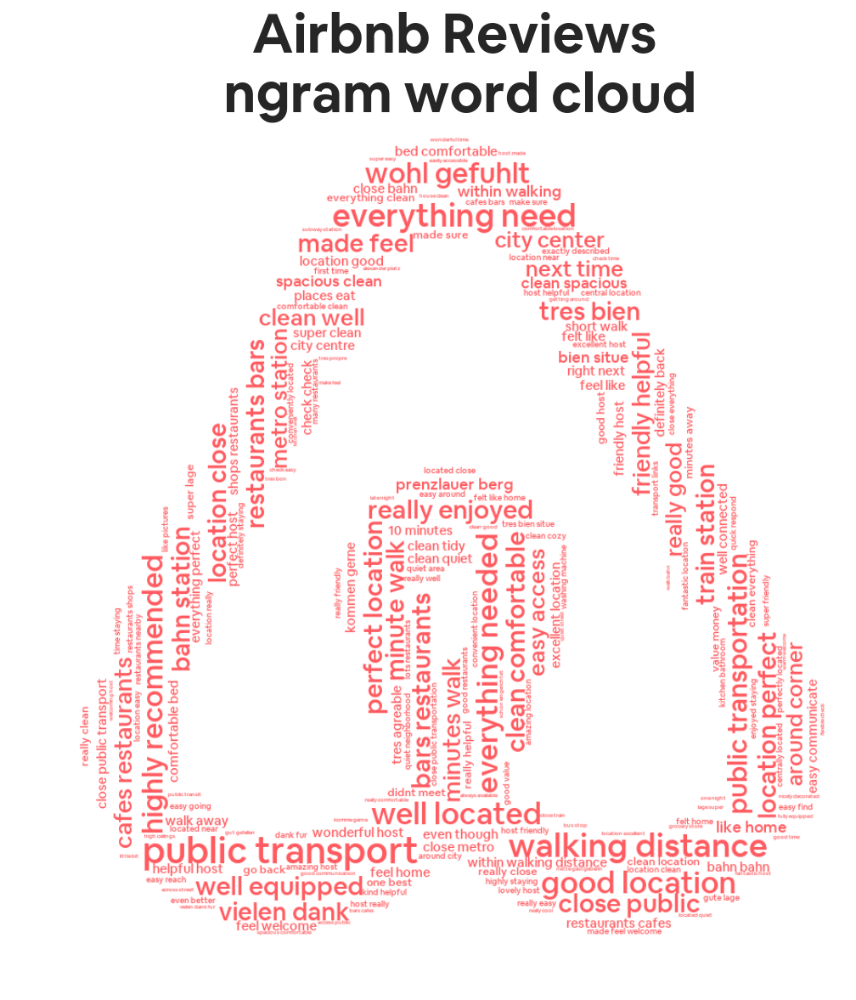

In [82]:
word_cloud_gen(cvec_pos_ngram,air_bnb_logo,'Airbnb Reviews\n ngram word cloud')

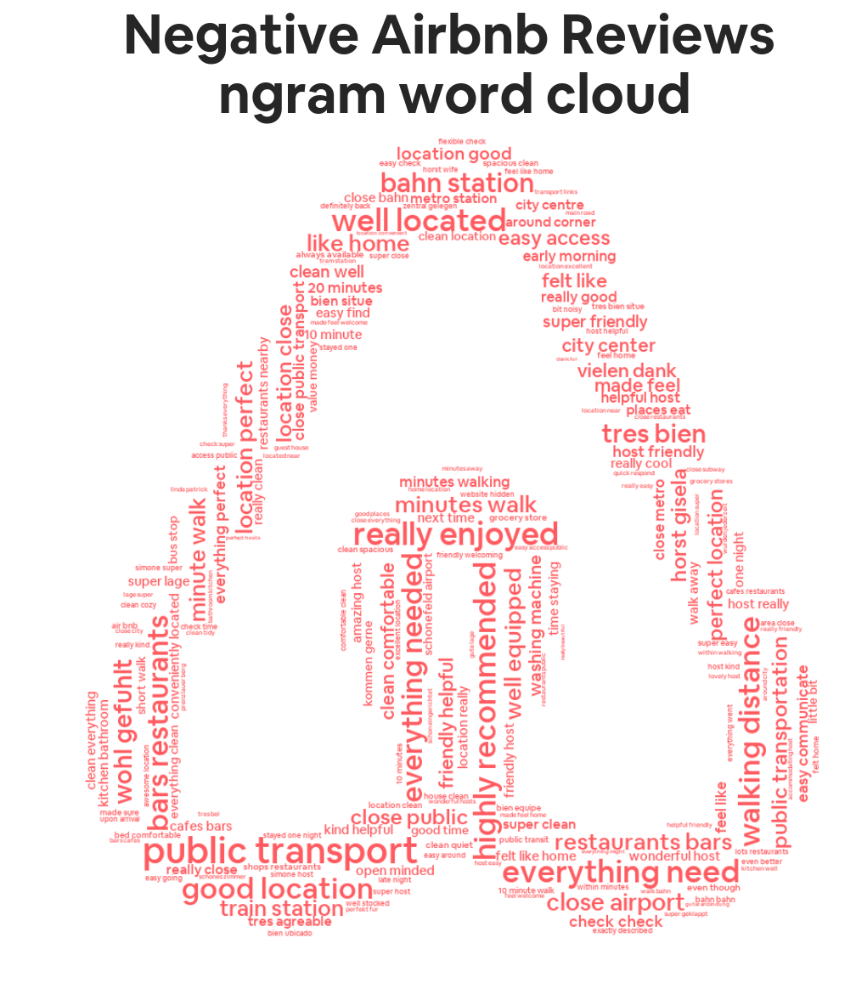

In [83]:
word_cloud_gen(neg_words_ngram,air_bnb_logo,'Negative Airbnb Reviews \nngram word cloud')

In [88]:
# Empty the variables to free up some space
cvec_matrix=[]
tfidf_matrix=[]
neg_words_ngram=[]
cvec_pos_ngram=[]
neg_words=[]
cvec_pos=[]
tfidf_df =[]
cvec=[]
tfidf =[]

## Process using textacy and topic modelling

### Lets look at the reviews individually first

In [25]:
host_names =set([name.replace('+',"").replace("&","").split(" ")[0] for name in host_names if len(name) >=3])

nlp = textacy.load_spacy('en_core_web_sm')
#nlp = textacy.load_spacy('xx_ent_wiki_sm')
nlp.Defaults.stop_words |= {'apartment','stay', 'berlin','Berlin', 'airbnb', 'appartement','apartement', 
                            'flat', 'room', 'stay', 'much', 'could', 'wohnung','get','would','us',
                            'und','s','get','place','ist','t','de','y','muy','de','en','la','es','que','el',
                            'con','El','the','The','It','it','A'}
nlp.Defaults.stop_words |=set(stop)
nlp.Defaults.stop_words |=set(reviews_en.reviewer_name)
nlp.Defaults.stop_words |= host_names

In [74]:
rev = reviews_en['comments'].values
clean_text = [preprocess_text(x, fix_unicode=True,no_urls=True, no_emails=True, no_phone_numbers=True, 
                              no_currency_symbols=True,no_contractions=False,lowercase=False,
                              no_punct=True)for x in rev]


In [76]:
review_corpus = textacy.Corpus(nlp, texts = clean_text)

In [78]:
vectorizer = textacy.Vectorizer(tf_type='linear', apply_idf=True, idf_type='smooth', norm='l2',
                                min_df=5, max_df=1.)
doc_term_matrix = vectorizer.fit_transform((doc.to_terms_list(ngrams=(1,2,3),normalize='lemma',
                            named_entities=False,filter_stops=True,filter_punct=True,filter_nums=True,
                               as_strings=True,exclude_types={'GPE','PERSON'},exclude_pos={'PRON'}) for doc in review_corpus))
print(repr(doc_term_matrix))

<263457x119340 sparse matrix of type '<class 'numpy.float64'>'
	with 9241192 stored elements in Compressed Sparse Row format>


In [79]:
vectorizer.terms_list[100:120]

['-PRON- comfortable',
 '-PRON- communication',
 '-PRON- contact',
 '-PRON- cosy',
 '-PRON- cousin',
 '-PRON- dad',
 '-PRON- daughter',
 '-PRON- daughter enjoy',
 '-PRON- daughter love',
 '-PRON- daughter stay',
 '-PRON- day',
 '-PRON- description',
 '-PRON- direction',
 '-PRON- dog',
 '-PRON- dog jack',
 '-PRON- easy',
 '-PRON- english',
 '-PRON- entire',
 '-PRON- entire stay',
 '-PRON- exactly']

In [80]:
textacy_df = pd.DataFrame(doc_term_matrix.sum(axis=0).ravel(),
                 columns=vectorizer.terms_list).T.sort_index(by=0, ascending=False)[:1000]
textacy_df[:10]

,0
great,8737.082119
the,7598.668328
place,7532.542941
stay,7322.952059
apartment,7311.985701
nice,6699.923195
location,5680.869428
s,5658.616324
good,5524.200905
host,5494.927425


In [84]:
textacy_df.T['tom']

0    223.151017
Name: tom, dtype: float64

#### Topic Modelling

In [85]:
topic_model = textacy.tm.TopicModel('nmf', n_topics=30)
topic_model.fit(doc_term_matrix)
topic_model

TopicModel(n_topics=30, model=NMF)

In [86]:
doc_topic_matrix = topic_model.transform(doc_term_matrix)
for topic_idx, top_terms in topic_model.top_topic_terms(vectorizer.id_to_term, 
                                                        topics=[0,1,2,3,4,5,6,7,8,9,10]):
    print('topic', topic_idx, ':', '   '.join(top_terms))

topic 0 : apartment   the apartment   the   clean   locate   s apartment   spacious   apartment be clean   beautiful   comfortable
topic 1 : great   great stay   great apartment   great host   location be great   place be great   great area   great experience   great neighborhood   great value
topic 2 : great place   place   great   place to stay   great place great   place great   a great place   a great   place great location   place and great
topic 3 : nice   nice place   nice host   nice apartment   nice stay   nice and clean   nice location   really nice   really   nice room
topic 4 : highly   highly recommend   recommend   highly recommend stay   recommend stay   would highly   would highly recommend   recommend this place   host highly   host highly recommend
topic 5 : good   good location   location   good place   good host   very good   value   good value   good communication   communication
topic 6 : room   the room   the   clean   big   comfortable   spacious   bathroom   ro

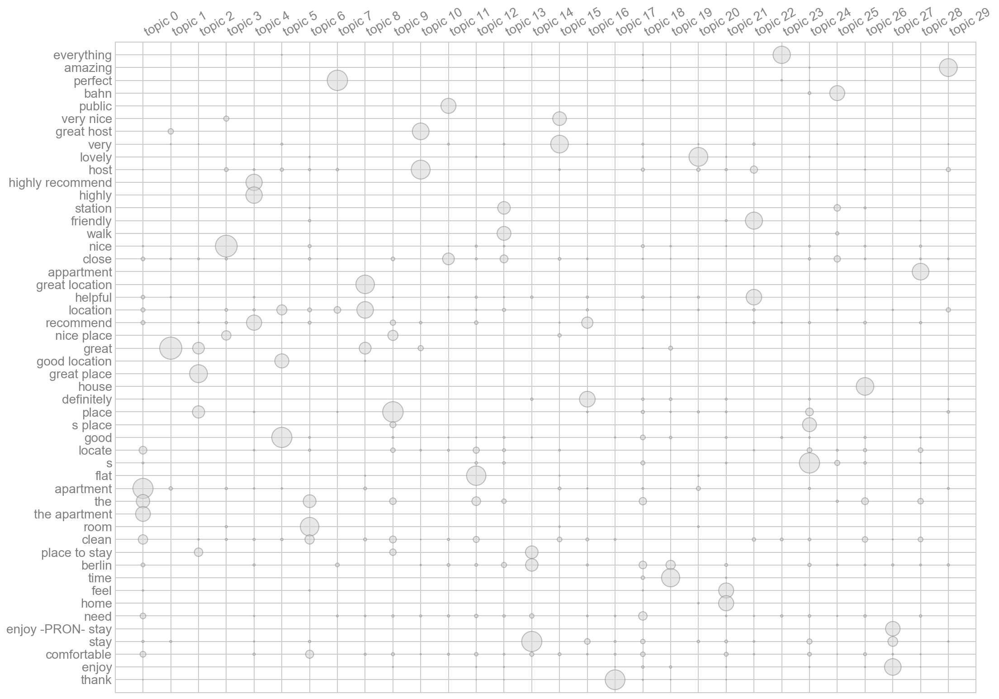

In [87]:
topic_model.termite_plot(doc_term_matrix, vectorizer.id_to_term, topics=-1,  n_terms=50, 
                         sort_terms_by='seriation')
topic_model.save('{0}_topic_model.pkl'.format(city))


In [96]:
doc_topic_matrix.shape

(263457, 30)

In [71]:
scipy.sparse.save_npz('tex_doc_mat.npz', doc_topic_matrix)
np.save('tex_topic_mat.csv', doc_topic_matrix)
filename = 'review_corpus.sav'
#pickle.dump(review_corpus, open(filename, 'wb'))

NameError: name 'doc_topic_matrix' is not defined

In [89]:
#review_corpus.save('review_corpus.pkl')
#review_corpus = textacy.Corpus.load('~/Desktop/congress.pkl')

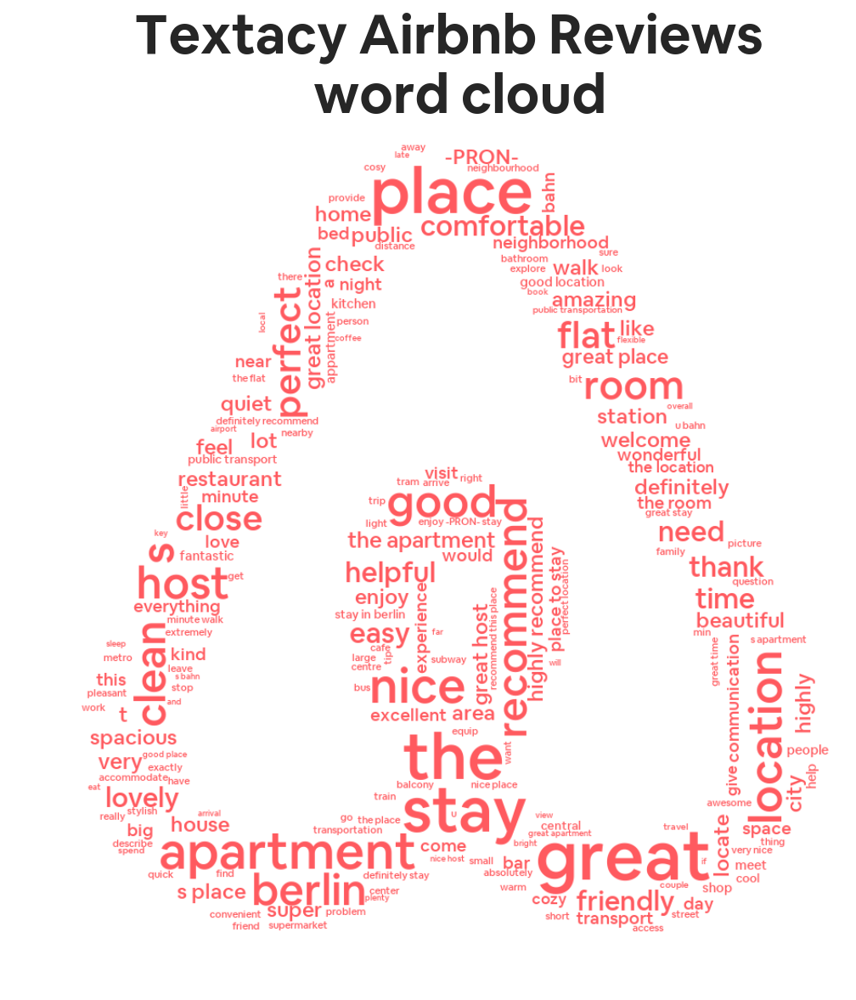

In [92]:
word_cloud_gen(textacy_df,air_bnb_logo,'Textacy Airbnb Reviews \n word cloud')
#Lets empty the lists to free up some memory
#textacy_df=[]
#topic_model=[]


### Now we look at the aggregated reviews for each listing

In [13]:
listing_text = df_ids.comments_grouped.values

listing_clean_text = [preprocess_text(x, fix_unicode=True,no_urls=True, no_emails=True, no_phone_numbers=True, 
                              no_currency_symbols=True,no_contractions=False,lowercase=True,
                              no_punct=True) for x in listing_text]


In [26]:
listing_corpus = textacy.Corpus(nlp, texts = listing_clean_text)

In [31]:
listing_corpus[30]

Doc(6007 tokens; "alan and kasia are fantastic hosts the apartmen...")

In [38]:
textacy.io.spacy.write_spacy_docs(listing_corpus, './{}listing_corpus.pkl', make_dirs=False, format='pickle', include_tensor=False)
#listing_corpus.save('./{}listing_corpus.pkl'.format(city))

TypeError: __init__() got an unexpected keyword argument 'encoding'

In [39]:
listing_vectorizer = textacy.Vectorizer(tf_type='linear', apply_idf=True, idf_type='smooth', norm='l2',
                                min_df=5, max_df=1.0)
listing_doc_term_matrix = listing_vectorizer.fit_transform((doc.to_terms_list(ngrams=(1,2),normalize='lemma',
                            named_entities=False,filter_stops=True,filter_punct=True,filter_nums=True,
                               as_strings=True,exclude_types={'GPE','PERSON'},exclude_pos={'PRON'}) for doc in listing_corpus))
print(repr(listing_doc_term_matrix))


<16849x116455 sparse matrix of type '<class 'numpy.float64'>'
	with 6295471 stored elements in Compressed Sparse Row format>


In [40]:
listing_vectorizer.terms_list[:10]

['+',
 '+ +',
 '+ baby',
 '+ bar',
 '+ bathroom',
 '+ bus',
 '+ check',
 '+ clean',
 '+ close',
 '+ comfortable']

In [46]:
listing_textacy_df = pd.DataFrame(listing_doc_term_matrix.sum(axis=0).ravel(),
                 columns=listing_vectorizer.terms_list).T.sort_index(by=0, ascending=False)[:1000]
listing_textacy_df[:20]

,0
great,1113.437486
apartment,1064.838260
stay,1054.274092
place,1040.831015
nice,875.392570
die,793.901977
host,709.418673
good,700.191414
room,687.369214
location,687.303172


#### Topic modelling

In [47]:
list_topic_model = textacy.tm.TopicModel('nmf', n_topics=30)
list_topic_model.fit(listing_doc_term_matrix)
list_topic_model

TopicModel(n_topics=30, model=NMF)

In [48]:
list_doc_topic_matrix = list_topic_model.transform(listing_doc_term_matrix)
for topic_idx, top_terms in list_topic_model.top_topic_terms(listing_vectorizer.id_to_term,
                                                             topics=[0,1,2,3,4,5,6,7,8,9,10]):
    print('topic', topic_idx, ':', '   '.join(top_terms))

topic 0 : stay   apartment   place   great   good   location   nice   clean   need   easy
topic 1 : die   war   man   hat   es   gut   den   von   lage   sauber
topic 2 : de   la   el   en   es   con   un   lo   del   casa
topic 3 : clean   locate   comfortable   tidy   super clean   recommend   nice clean   clean apartment   sauber   close
topic 4 : et   très   de   est   le   pour   bien   un   la   lappartement
topic 5 : great   location   great location   great place   great host   great stay   great time   great apartment   communication   easy
topic 6 : host   friendly   great host   great   helpful   friendly host   recommend   kind   nice host   amazing
topic 7 : room   big   nice   zimmer   spacious   friendly   bathroom   hide   bed   nice room
topic 8 : nice   nice place   nice host   nice stay   nice apartment   area   nice room   nice flat   nice area   super nice
topic 9 : e   di   molto   la   il   casa   che   non   un   si
topic 10 : place   great place   nice place   

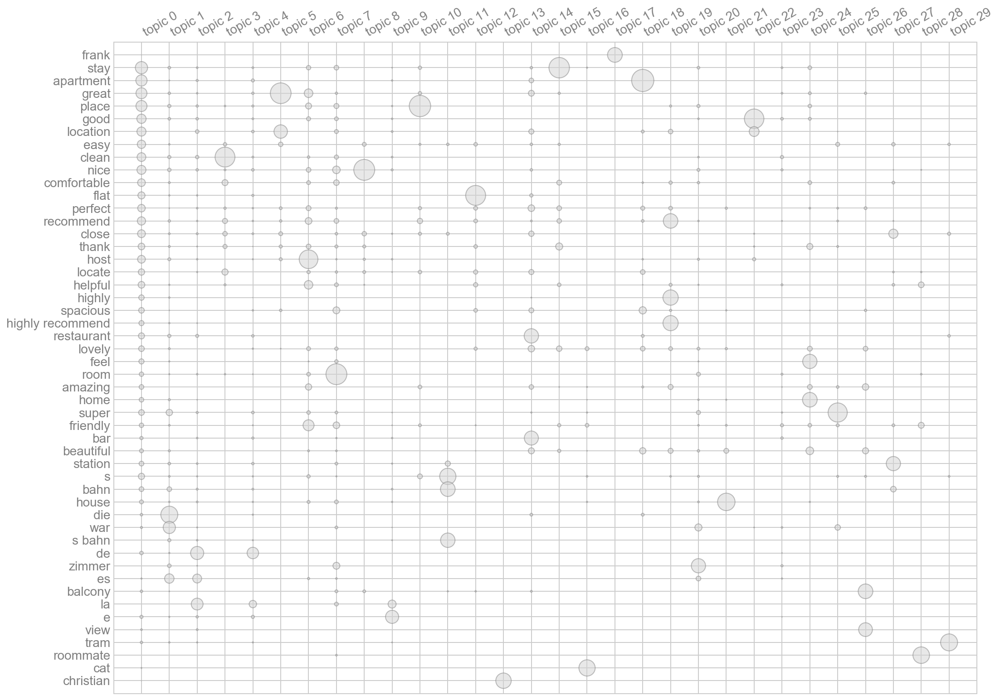

In [49]:
list_topic_model.termite_plot(listing_doc_term_matrix, listing_vectorizer.id_to_term, topics=-1, 
                                     n_terms=50, sort_terms_by='seriation')

list_topic_model.save('list_{0}_topic_model.pkl'.format(city))

In [51]:
scipy.sparse.save_npz('list_tex_doc_mat.npz', listing_doc_term_matrix)
filename = 'listing_corpus.sav'

np.save('listing_topic_mat.csv', list_doc_topic_matrix)
#pickle.dump(listing_corpus, open(filename, 'wb'))
#review_corpus = textacy.Corpus.load('~/Desktop/congress.pkl')

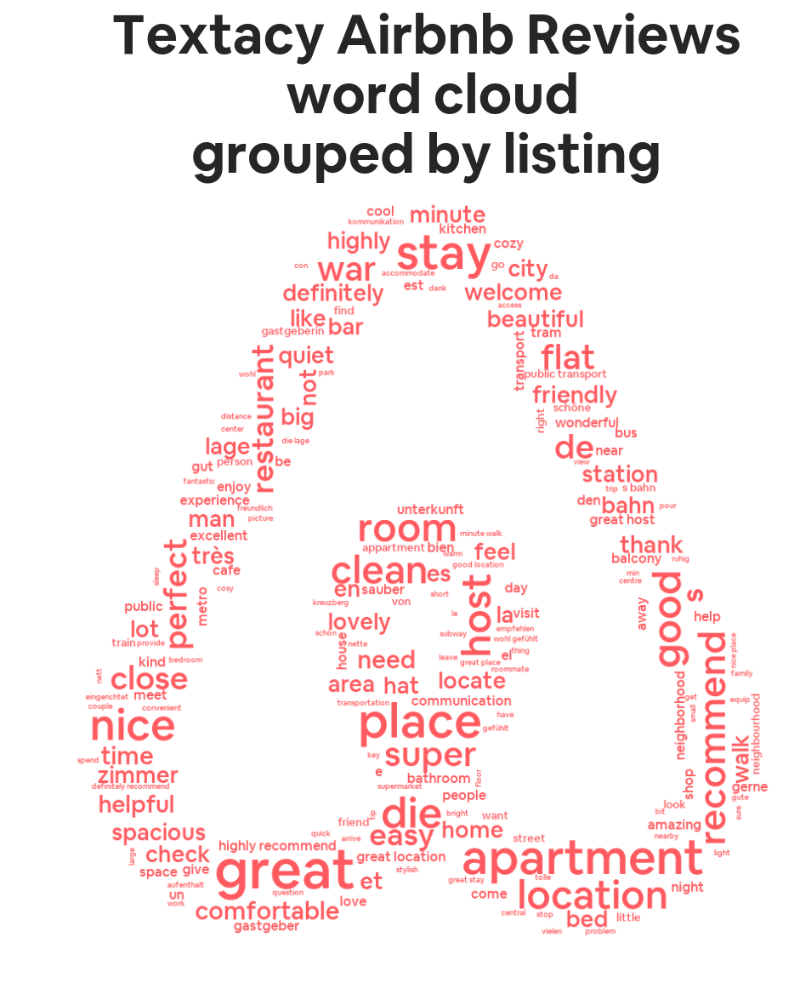

In [54]:
word_cloud_gen(listing_textacy_df,air_bnb_logo,'Textacy Airbnb Reviews\n word cloud\ngrouped by listing')

In [ ]:
# Clear the Variables to free up memory
#listing_textacy_df=[]
#list_topic_model=[]

## Descriptions

In [60]:
descriptions[:20]

id
2015     Great location!  30 of 75 sq meters. This wood...
2695     In the summertime we are spending most of our ...
3176     This beautiful first floor apartment  is situa...
3309     First of all: I prefer short-notice bookings. ...
7071     Cozy and large room in the beautiful district ...
9991     4 bedroom with very large windows and outstand...
14325    The apartment is located on the upper second f...
16401    Hello future guests! We want to rent our cute ...
16644    Light and sunny 2-Room-turn of the century-fla...
17409    The 25 sqm room is located in the heart of Ber...
17904    - beautiful studio apt in downtown Berlin - br...
20858    Bright and sunny condo with two balconies in a...
21869    Light and sunny 1-Room-turn of the century-fla...
22415    Very nice furnished 2 bedroom apartment for su...
22677    Comfortable, cozy and quiet 70m2 apartment plu...
23834    Beautiful and calm apartment in close vicinity...
24569    The apartment has 150 sqm and is on the 4th 

In [70]:
cvec_desc = CountVectorizer(analyzer='word',
                       stop_words=stop,
                       strip_accents='unicode',
                       lowercase=True,
                       ngram_range=(1,3),
                       min_df=5,
                       )
cvec_desc.fit(descriptions.fillna(' '))
cvec_desc_matrix = cvec_desc.transform(descriptions.fillna(' '))
cvec_desc_matrix
cvec_desc = pd.DataFrame(cvec_desc_matrix.sum(axis=0).ravel(),
                 columns=cvec_desc.get_feature_names()).T.sort_index(by=0, ascending=False)[:1000]

In [69]:
cvec_desc_matrix

<22552x28397 sparse matrix of type '<class 'numpy.int64'>'
	with 1730613 stored elements in Compressed Sparse Row format>

In [68]:
cvec_desc[:20]

,0
kitchen,14083
bed,9805
bathroom,8990
restaurants,8680
located,8066
living,7930
bars,7666
bahn,7412
minutes,7167
one,7000
